# <center> Tutorial - Extracting Solar PV info from OpenStreetMap </center>

In this notebook, we explore several ways to download, manipulate and plot OSM data. We work with points and polygons using `shapely`, `geopandas` and `geojson`, and we plot interactive maps with `folium` and `geojsonio`.

The data we use throughout the notebook is solar tags information from OSM, with the initial goal of extracting solar panels coordinates - which would then be useful to download corresponding satellite image tiles. 

In the 1st section, we do successively the same work, same manipulations and same plotting for PV panels in the UK, France, Belgium and the Netherlands. In the 2nd section we use another OSM data extraction method for the same countries, and we try to compute PV-related statistics (area, power).

<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Work-with-raw-OSM-data" data-toc-modified-id="Work-with-raw-OSM-data-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Work with raw OSM data</a></span><ul class="toc-item"><li><span><a href="#UK" data-toc-modified-id="UK-1.1"><span class="toc-item-num">1.1&nbsp;&nbsp;</span>UK</a></span><ul class="toc-item"><li><span><a href="#Query" data-toc-modified-id="Query-1.1.1"><span class="toc-item-num">1.1.1&nbsp;&nbsp;</span>Query</a></span></li><li><span><a href="#Plot-nodes" data-toc-modified-id="Plot-nodes-1.1.2"><span class="toc-item-num">1.1.2&nbsp;&nbsp;</span>Plot nodes</a></span></li><li><span><a href="#Plot-nodes-interactively" data-toc-modified-id="Plot-nodes-interactively-1.1.3"><span class="toc-item-num">1.1.3&nbsp;&nbsp;</span>Plot nodes interactively</a></span></li><li><span><a href="#Tentatives---understanding-nodes-&amp;-polygons" data-toc-modified-id="Tentatives---understanding-nodes-&amp;-polygons-1.1.4"><span class="toc-item-num">1.1.4&nbsp;&nbsp;</span>Tentatives - understanding nodes &amp; polygons</a></span></li><li><span><a href="#Extract-and-save-all-polygons" data-toc-modified-id="Extract-and-save-all-polygons-1.1.5"><span class="toc-item-num">1.1.5&nbsp;&nbsp;</span>Extract and save all polygons</a></span></li><li><span><a href="#Plot-polygons" data-toc-modified-id="Plot-polygons-1.1.6"><span class="toc-item-num">1.1.6&nbsp;&nbsp;</span>Plot polygons</a></span></li></ul></li><li><span><a href="#France" data-toc-modified-id="France-1.2"><span class="toc-item-num">1.2&nbsp;&nbsp;</span>France</a></span><ul class="toc-item"><li><span><a href="#Query" data-toc-modified-id="Query-1.2.1"><span class="toc-item-num">1.2.1&nbsp;&nbsp;</span>Query</a></span></li><li><span><a href="#Plot-nodes" data-toc-modified-id="Plot-nodes-1.2.2"><span class="toc-item-num">1.2.2&nbsp;&nbsp;</span>Plot nodes</a></span></li><li><span><a href="#Plot-nodes-interactively" data-toc-modified-id="Plot-nodes-interactively-1.2.3"><span class="toc-item-num">1.2.3&nbsp;&nbsp;</span>Plot nodes interactively</a></span></li><li><span><a href="#Extract-and-save-all-Polygons" data-toc-modified-id="Extract-and-save-all-Polygons-1.2.4"><span class="toc-item-num">1.2.4&nbsp;&nbsp;</span>Extract and save all Polygons</a></span></li><li><span><a href="#Plot-polygons" data-toc-modified-id="Plot-polygons-1.2.5"><span class="toc-item-num">1.2.5&nbsp;&nbsp;</span>Plot polygons</a></span></li></ul></li><li><span><a href="#Belgium" data-toc-modified-id="Belgium-1.3"><span class="toc-item-num">1.3&nbsp;&nbsp;</span>Belgium</a></span><ul class="toc-item"><li><span><a href="#Query" data-toc-modified-id="Query-1.3.1"><span class="toc-item-num">1.3.1&nbsp;&nbsp;</span>Query</a></span></li><li><span><a href="#Plot-nodes" data-toc-modified-id="Plot-nodes-1.3.2"><span class="toc-item-num">1.3.2&nbsp;&nbsp;</span>Plot nodes</a></span></li><li><span><a href="#Plot-nodes-interactively" data-toc-modified-id="Plot-nodes-interactively-1.3.3"><span class="toc-item-num">1.3.3&nbsp;&nbsp;</span>Plot nodes interactively</a></span></li><li><span><a href="#Extract-and-save-all-Polygons" data-toc-modified-id="Extract-and-save-all-Polygons-1.3.4"><span class="toc-item-num">1.3.4&nbsp;&nbsp;</span>Extract and save all Polygons</a></span></li><li><span><a href="#Plot-polygons" data-toc-modified-id="Plot-polygons-1.3.5"><span class="toc-item-num">1.3.5&nbsp;&nbsp;</span>Plot polygons</a></span></li></ul></li><li><span><a href="#Netherlands" data-toc-modified-id="Netherlands-1.4"><span class="toc-item-num">1.4&nbsp;&nbsp;</span>Netherlands</a></span><ul class="toc-item"><li><span><a href="#Query" data-toc-modified-id="Query-1.4.1"><span class="toc-item-num">1.4.1&nbsp;&nbsp;</span>Query</a></span></li><li><span><a href="#Plot-nodes" data-toc-modified-id="Plot-nodes-1.4.2"><span class="toc-item-num">1.4.2&nbsp;&nbsp;</span>Plot nodes</a></span></li><li><span><a href="#Plot-nodes-interactively" data-toc-modified-id="Plot-nodes-interactively-1.4.3"><span class="toc-item-num">1.4.3&nbsp;&nbsp;</span>Plot nodes interactively</a></span></li><li><span><a href="#Extract-and-save-all-Polygons" data-toc-modified-id="Extract-and-save-all-Polygons-1.4.4"><span class="toc-item-num">1.4.4&nbsp;&nbsp;</span>Extract and save all Polygons</a></span></li><li><span><a href="#Plot-polygons" data-toc-modified-id="Plot-polygons-1.4.5"><span class="toc-item-num">1.4.5&nbsp;&nbsp;</span>Plot polygons</a></span></li></ul></li></ul></li><li><span><a href="#Work-directly-with-OSM-geojson-files" data-toc-modified-id="Work-directly-with-OSM-geojson-files-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Work directly with OSM geojson files</a></span><ul class="toc-item"><li><span><a href="#UK" data-toc-modified-id="UK-2.1"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>UK</a></span><ul class="toc-item"><li><span><a href="#Export-geojson-from-Overpass-API" data-toc-modified-id="Export-geojson-from-Overpass-API-2.1.1"><span class="toc-item-num">2.1.1&nbsp;&nbsp;</span>Export geojson from Overpass API</a></span></li><li><span><a href="#Compute-polygon-areas-&amp;-power" data-toc-modified-id="Compute-polygon-areas-&amp;-power-2.1.2"><span class="toc-item-num">2.1.2&nbsp;&nbsp;</span>Compute polygon areas &amp; power</a></span></li></ul></li><li><span><a href="#France" data-toc-modified-id="France-2.2"><span class="toc-item-num">2.2&nbsp;&nbsp;</span>France</a></span><ul class="toc-item"><li><span><a href="#Export-geojson-from-Overpass-API" data-toc-modified-id="Export-geojson-from-Overpass-API-2.2.1"><span class="toc-item-num">2.2.1&nbsp;&nbsp;</span>Export geojson from Overpass API</a></span></li><li><span><a href="#Compute-polygon-areas-&amp;-power" data-toc-modified-id="Compute-polygon-areas-&amp;-power-2.2.2"><span class="toc-item-num">2.2.2&nbsp;&nbsp;</span>Compute polygon areas &amp; power</a></span></li></ul></li><li><span><a href="#Belgium" data-toc-modified-id="Belgium-2.3"><span class="toc-item-num">2.3&nbsp;&nbsp;</span>Belgium</a></span><ul class="toc-item"><li><span><a href="#Export-geojson-from-Overpass-API" data-toc-modified-id="Export-geojson-from-Overpass-API-2.3.1"><span class="toc-item-num">2.3.1&nbsp;&nbsp;</span>Export geojson from Overpass API</a></span></li><li><span><a href="#Compute-polygon-areas-&amp;-power" data-toc-modified-id="Compute-polygon-areas-&amp;-power-2.3.2"><span class="toc-item-num">2.3.2&nbsp;&nbsp;</span>Compute polygon areas &amp; power</a></span></li></ul></li><li><span><a href="#Netherlands" data-toc-modified-id="Netherlands-2.4"><span class="toc-item-num">2.4&nbsp;&nbsp;</span>Netherlands</a></span><ul class="toc-item"><li><span><a href="#Export-geojson-from-Overpass-API" data-toc-modified-id="Export-geojson-from-Overpass-API-2.4.1"><span class="toc-item-num">2.4.1&nbsp;&nbsp;</span>Export geojson from Overpass API</a></span></li><li><span><a href="#Compute-polygon-areas-&amp;-power" data-toc-modified-id="Compute-polygon-areas-&amp;-power-2.4.2"><span class="toc-item-num">2.4.2&nbsp;&nbsp;</span>Compute polygon areas &amp; power</a></span></li></ul></li></ul></li></ul></div>

In [1]:
# file manipulation imports
import pandas as pd
import os
import pickle
import json
import geojson
from geojson import Point, Feature, FeatureCollection, dump
import geopandas as gpd
from shapely.geometry import Polygon, Point, asShape, mapping, shape

# visualization imports
import matplotlib.pyplot as plt
%matplotlib inline
import folium
from folium import IFrame
from folium.plugins import MarkerCluster
import geojsonio

# other imports
import warnings
warnings.filterwarnings("ignore")
import requests

## Work with raw OSM data

### UK

#### Query

The function below queries raw OSM data for a specified country through the Overpass API, and writes a pickle file in the specified folder. If used for the 2nd time, it can also just import the pickle file (faster). Make sure you specify the right folder and file names.

In [3]:
# Adapted from Sylwia
# https://github.com/SylwiaOliwia2/uk-photovoltaics-map/blob/master/data_preprocessing/functions_panels_amount.py

def getSolarPanelsFromOSM(country="country", read_from_pickle=False, pickle_read_name=None, 
                          pickle_write_name="osm_panels", folder_with_output_files='data'):
    
    print("Query Open Street Map for solar panels in {}.".format(country))
    
    # either load pickle data or query overpass
    dirname = '../Data'
    if read_from_pickle:
        with open(os.path.join(dirname, folder_with_output_files, pickle_read_name + ".pkl"), 'rb') as f:
             osm_queried_panels = pickle.load(f)
    else:
        overpass_url = "http://overpass-api.de/api/interpreter"

        # query all solar panels saved as polygon
        solar_ways_query = """
            [out:json];
            area["int_name"="{}"]->.searchArea;
            (
            way(area.searchArea)["generator:source"="solar"]['generator:output:electricity'='yes'];
            );
            out body;
            >;
            out skel qt;
        """.format(country)
        ways_solar = requests.get(overpass_url, params={'data': solar_ways_query}).json()
        
        # to simplify, one polygon = one panel, and panel will get coordinates of the first node of polygon
        first_node_ids = [element["nodes"][0] for element in ways_solar["elements"] if element["type"] == "way"]
        panels_from_polygon = [element for element in ways_solar["elements"] if element["id"] in first_node_ids]

        # query all solar panels saved as points (nodes)
        solar_nodes_query = """
            [out:json];
            area["int_name"="{}"]->.searchArea;
            (
             node(area.searchArea)["generator:source"="solar"]['generator:output:electricity'='yes'];
            );
            out body;
            >;
            out skel qt;
        """.format(country)
        panels_from_nodes = requests.get(overpass_url, params={'data': solar_nodes_query}).json()

        osm_queried_panels = panels_from_nodes["elements"] + panels_from_polygon
        osm_queried_panels = ways_solar['elements'] # we assign osm_queried_panels twice?

        with open(os.path.join(dirname, folder_with_output_files, pickle_write_name + ".pkl"), 'wb') as f:
            pickle.dump(osm_queried_panels, f)
    print("Done.")

    return osm_queried_panels

In [4]:
osm_pv = getSolarPanelsFromOSM(country="United Kingdom", read_from_pickle=True, pickle_read_name='uk_panels', 
                               pickle_write_name="uk_panels", folder_with_output_files='OSM_coord')

Query Open Street Map for solar panels in United Kingdom.
Done.


In [23]:
# Convert to dataframe
osm_df = pd.DataFrame(osm_pv)
osm_df.head(1)

,type,id,nodes,tags,lat,lon
0,way,21819997,"[235214393, 718952965, 718952985, 718952926, 7...","{'PMSA_ref': 'WMbiBIxx207', 'architect': 'Faul...",NaN,NaN


In [24]:
# Count nb of nodes and ways
print(len(osm_df))
print(osm_df.groupby('type').count())
# len(osm_df[osm_df['lat'].isna()]) # alternative way of counting ways

98454
         id  nodes   tags    lat    lon
type                                   
node  85241      0      0  85241  85241
way   13213  13213  13213      0      0


We can see that there are really lots of nodes (+85k). This is because **all summit points from solar ways areas (+13k, times the nb summits each time) are cast as nodes**. Put in another way, nodes include **solar panels tagged as points _and_ summits of all solar panels tagged as ways**.

In this notebook, we will work both with nodes (to plot the whole of OSM data) and with ways (to reconstruct polygon areas based on summit nodes).

In [25]:
# Convert to geo dataframe
osm_df['geometry'] = list(zip(osm_df['lon'], osm_df['lat']))
osm_df['geometry'] = osm_df['geometry'].apply(lambda x: Point(x))
osm_df = gpd.GeoDataFrame(osm_df, crs={'init': 'epsg:4326'}) # OSM comes in this coordinate system
osm_df.head(1)

,type,id,nodes,tags,lat,lon,geometry
0,way,21819997,"[235214393, 718952965, 718952985, 718952926, 7...","{'PMSA_ref': 'WMbiBIxx207', 'architect': 'Faul...",NaN,NaN,POINT (nan nan)


#### Plot nodes

In [26]:
# Change to British National Grid coordinates for plotting
osm_bng = osm_df.to_crs({'init':'epsg:27700'})

To plot all nodes on a static map, you need to download the country shapefile through this [link](http://www.diva-gis.org/gdata). Make sure you choose the "administrative area", that you specify the right folder in the cell below, and that you keep in the folder all the annex files that come with the download.

In [27]:
# Grab UK outline (crs epsg:4326) and change to BNG coordinates
gb_outline = gpd.read_file('../Data/OSM_coord/GBR_adm/GBR_adm1.shp').to_crs({'init':'epsg:27700'})

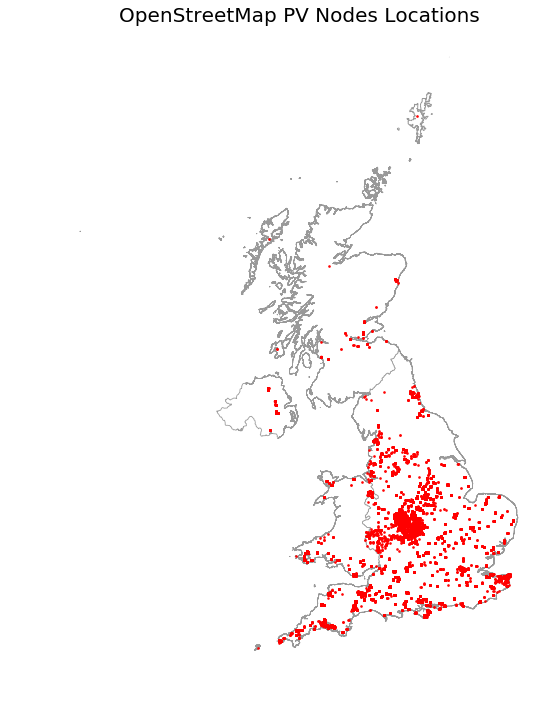

In [28]:
# Plot
fig, ax = plt.subplots(1, figsize=(12, 12))
gb_outline.plot(ax=ax, color='white', linewidth=0.8, edgecolor='0.6')
osm_bng.plot(ax=ax, markersize=2, color='red', alpha=0.4)

ax.set_title("OpenStreetMap PV Nodes Locations", fontdict={'fontsize': '20', 'fontweight' : '3'})
ax.axis('off')
plt.show()

#### Plot nodes interactively
Folium wants WGS 84 coordinates so we can use the original dataframe, rather than `osm_bng`.

In [29]:
# Store all nodes coordinates for plotting
osm_folium = osm_df[osm_df.lat.notna()]
print(len(osm_folium))
osm_folium.head(1)

85241


,type,id,nodes,tags,lat,lon,geometry
13213,node,6798412476,NaN,NaN,49.915885,-6.308284,POINT (-6.30828 49.91588)


For interactive plotting we will use `folium` interactive maps. The `popups` attribute make sure that you can see coordinates of each point (node) by clicking on it.

In [30]:
m = folium.Map([50.751, -1.9950], zoom_start=6, tiles='cartodbpositron')
# other possible tile styles: ["Stamen Terrain", "Stamen Toner", "Mapbox Bright"]

locations = []
popups = []
for idx, row in osm_folium[:10000].iterrows():
    locations.append([row['geometry'].y, row['geometry'].x])
    popups.append((row['geometry'].y, row['geometry'].x))

s = folium.FeatureGroup(name='Solar PV')
s.add_children(MarkerCluster(locations=locations, popups=popups))
m.add_children(s)
m.add_child(folium.LatLngPopup())

With a very large nb of points to plot (for UK, +85k), `folium` might break - if so, you can just plot the first 10k points (South-West of GB) for example.

#### Tentatives - understanding nodes & polygons

Let's try to extract polygon shapes from the OSM solar ways.

In [31]:
# Getting only ways from OSM
osm_pv = getSolarPanelsFromOSM(country="United Kingdom", read_from_pickle=True, pickle_read_name="uk_panels", 
                               pickle_write_name="uk_panels", folder_with_output_files='OSM_coord')
osm_df = pd.DataFrame(osm_pv)
ways = osm_df[osm_df.type=='way']
ways.head(3)

Query Open Street Map for solar panels in United Kingdom.
Done.


,type,id,nodes,tags,lat,lon
0,way,21819997,"[235214393, 718952965, 718952985, 718952926, 7...","{'PMSA_ref': 'WMbiBIxx207', 'architect': 'Faul...",NaN,NaN
1,way,29169304,"[320803617, 320803618, 320803619, 5269455022, ...","{'building': 'yes', 'generator:method': 'photo...",NaN,NaN
2,way,40292890,"[486078905, 486078907, 486078909, 486078911, 4...","{'amenity': 'public_building', 'building': 'ye...",NaN,NaN


For each way, the `nodes` feature contains a list of nodes, which are the summits of the corresponding polygon.

In [32]:
ways['nodes'][0]

[235214393,
 718952965,
 718952985,
 718952926,
 718952953,
 718953038,
 718952918,
 235214399,
 235214404,
 718952996,
 718953011,
 718953021,
 718952903,
 718952938,
 718952913,
 718952975,
 718953004,
 718952920,
 718953042,
 235214407,
 235214393]

As you can see above, the list of nodes contains node `IDs`. We can access each of these nodes in the full dataframe.

In [33]:
node_search = osm_df['id'] == ways['nodes'][0][0]
osm_df[node_search]

,type,id,nodes,tags,lat,lon
59227,node,235214393,NaN,NaN,52.460309,-1.844692


Got it! We have the coordinates of the first summit of the first solar way.

Let's now rebuild the polygon corresponding to the first solar way.

In [34]:
# extract coordinates of all summits of the 1st solar way
summits = list()
for i in ways['nodes'][0]:
    node_search = osm_df['id'] == i
    node_coords = osm_df[node_search]['lat'].append(osm_df[node_search]['lon']).values
    summits.append(list(node_coords))
print(summits)

[[52.460309, -1.8446924], [52.4601234, -1.8443053], [52.4601571, -1.8442619], [52.4600219, -1.8439798], [52.4600585, -1.8439325], [52.4599617, -1.8437306], [52.4600288, -1.8436439], [52.4599427, -1.8434643], [52.4595284, -1.8439991], [52.4595503, -1.8440447], [52.4594302, -1.8441997], [52.4594666, -1.8442756], [52.4595603, -1.8441546], [52.4596269, -1.8442934], [52.4594333, -1.8445433], [52.4594825, -1.844646], [52.4596214, -1.8444667], [52.4597635, -1.844763], [52.4598029, -1.8447121], [52.4599905, -1.8451036], [52.460309, -1.8446924]]


In [35]:
# convert summit coordinates to Polygon shapely object
polygon = Polygon(summits)
print(type(polygon))
print(polygon)

<class 'shapely.geometry.polygon.Polygon'>
POLYGON ((52.460309 -1.8446924, 52.4601234 -1.8443053, 52.4601571 -1.8442619, 52.4600219 -1.8439798, 52.4600585 -1.8439325, 52.4599617 -1.8437306, 52.4600288 -1.8436439, 52.4599427 -1.8434643, 52.4595284 -1.8439991, 52.4595503 -1.8440447, 52.4594302 -1.8441997, 52.4594666 -1.8442756, 52.4595603 -1.8441546, 52.4596269 -1.8442934, 52.4594333 -1.8445433, 52.4594825 -1.844646, 52.4596214 -1.8444667, 52.4597635 -1.844763, 52.4598029 -1.8447121, 52.4599905 -1.8451036, 52.460309 -1.8446924))


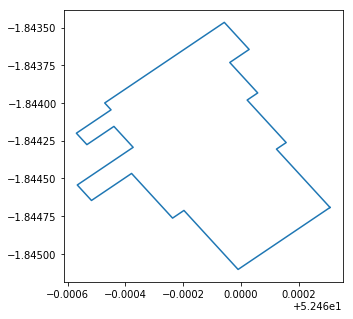

In [36]:
# plot shapely object
plt.figure(figsize=(5,5))
plt.plot(*polygon.exterior.xy)
plt.show()

In [37]:
# convert shapely object to geodataframe
polygon_geo = gpd.GeoDataFrame(index=[0], crs={'init': 'epsg:4326'}, geometry=[polygon])
type(polygon_geo)

geopandas.geodataframe.GeoDataFrame

In [40]:
# plot on folium map
m = folium.Map([50.3678999, 5.0428969], zoom_start=40, tiles='cartodbpositron')
#folium.GeoJson(polygon_geo).add_to(m)
m.add_child(folium.LatLngPopup())
m.add_child(folium.GeoJson(polygon_geo))
m.add_child(folium.LayerControl())
m

With the method explored above, we can now reconstruct all polygons from multiple node data, and save them to disk.

#### Extract and save all polygons

In [150]:
# drop ways with less than 3 nodes (i.e. not a polygon)
# because it breaks up the conversion to polygon in next cell
print(len(ways))
ways = ways[ways['nodes'].map(len) > 2]
ways.reset_index(drop=True, inplace=True)
print(len(ways))

In [179]:
# obtain shape coordinates of all solar ways
def get_coord(solar_way_to_search, full_data_extract):
    summits = list()
    for node in solar_way_to_search:
        node_search = full_data_extract['id'] == node
        node_coords = full_data_extract[node_search]['lon'].append(full_data_extract[node_search]['lat']).values
        summits.append(list(node_coords))
    return summits

all_shapes = [get_coord(ways['nodes'][i], osm_df) for i in range(len(ways))]

In [180]:
# convert shape coordinates to shapely polygons and to geodataframe
ways['geometry'] = all_shapes
ways['geometry'] = ways['geometry'].apply(lambda x: Polygon(x)) # convert to shapely Polygon
ways = gpd.GeoDataFrame(ways, crs={'init': 'epsg:4326'}) # convert to geodataframe
ways = ways.drop(columns=['lat', 'lon'])
ways.head(1)

,type,id,nodes,tags,geometry
0,way,21819997,"[235214393, 718952965, 718952985, 718952926, 7...","{'PMSA_ref': 'WMbiBIxx207', 'architect': 'Faul...","POLYGON ((-1.84469 52.46031, -1.84431 52.46012..."


In [181]:
# add centroids in order to have unique coordinates for each way
ways['centroid'] = ways['geometry'].centroid
ways.head(1)

,type,id,nodes,tags,geometry,centroid
0,way,21819997,"[235214393, 718952965, 718952985, 718952926, 7...","{'PMSA_ref': 'WMbiBIxx207', 'architect': 'Faul...","POLYGON ((-1.84469 52.46031, -1.84431 52.46012...",POINT (-1.84432 52.45988)


We now built a clean geodataframe with shapes and centroids of all solar ways. Our last step will be to write it to disk as a json / geojson file.

I remarked that, oddly, we cannot parse a geodataframe to json / geojson format when it includes a Point (the centroid). Therefore I will just separate the lat and lon of the centroid (2 possible methods below) before dumping the json file.

In [182]:
# method 1: get x and y coord of centroids based on Polygon
ways_for_json = ways
ways_for_json["centroid_lon"] = ways_for_json['geometry'].centroid.x
ways_for_json["centroid_lat"] = ways_for_json['geometry'].centroid.y
ways_for_json = ways_for_json.drop(columns=['centroid'])
ways_for_json.head(1)

,type,id,nodes,tags,geometry,centroid_lon,centroid_lat
0,way,21819997,"[235214393, 718952965, 718952985, 718952926, 7...","{'PMSA_ref': 'WMbiBIxx207', 'architect': 'Faul...","POLYGON ((-1.84469 52.46031, -1.84431 52.46012...",-1.844317,52.459882


In [183]:
# method 2: separate x and y coord of centroids with lambda
ways_for_json = ways
ways_for_json['centroid_lat'] = ways_for_json['centroid'].map(lambda p: p.x)
ways_for_json['centroid_lon'] = ways_for_json['centroid'].map(lambda p: p.y)
ways_for_json = ways_for_json.drop(columns=['centroid'])
ways_for_json.head(1)

,type,id,nodes,tags,geometry,centroid_lon,centroid_lat
0,way,21819997,"[235214393, 718952965, 718952985, 718952926, 7...","{'PMSA_ref': 'WMbiBIxx207', 'architect': 'Faul...","POLYGON ((-1.84469 52.46031, -1.84431 52.46012...",52.459882,-1.844317


In [184]:
# convert to json and write to disk
ways_for_json_full = ways_for_json.to_json()
with open('../Data/OSM_coord/uk_panels.geojson', 'w') as f:
    dump(ways_for_json, f)

Now it worked! We saved the json file with all solar ways shapes and centroid coordinates.

#### Plot polygons

Last, we can even visualize the json file in browser using `geojsonio`. Note that we only plot the first 100 panels, if we try to plot a too big file `geojsonio` tries to create a gist on GitHub and requires authentification.

In [186]:
# visualise geojson in browser
ways_for_json_plot = ways_for_json.head(100).to_json()
geojsonio.display(ways_for_json_plot)

'http://geojson.io/#data=data:application/json,%7B%22type%22%3A%20%22FeatureCollection%22%2C%20%22features%22%3A%20%5B%7B%22id%22%3A%20%220%22%2C%20%22type%22%3A%20%22Feature%22%2C%20%22properties%22%3A%20%7B%22centroid_lat%22%3A%20-1.844317326096401%2C%20%22centroid_lon%22%3A%2052.45988241075516%2C%20%22id%22%3A%2021819997%2C%20%22nodes%22%3A%20%5B235214393%2C%20718952965%2C%20718952985%2C%20718952926%2C%20718952953%2C%20718953038%2C%20718952918%2C%20235214399%2C%20235214404%2C%20718952996%2C%20718953011%2C%20718953021%2C%20718952903%2C%20718952938%2C%20718952913%2C%20718952975%2C%20718953004%2C%20718952920%2C%20718953042%2C%20235214407%2C%20235214393%5D%2C%20%22tags%22%3A%20%7B%22PMSA_ref%22%3A%20%22WMbiBIxx207%22%2C%20%22architect%22%3A%20%22Faulks%20Perry%20Culley%20%26%20Rech%22%2C%20%22artist_name%22%3A%20%22Richard%20Martin%22%2C%20%22artwork%3Aerected%22%3A%20%221997%22%2C%20%22artwork%3Atype%22%3A%20%22building%3Blight%20sculpture%22%2C%20%22building%22%3A%20%22industrial%22%2

Careful, however: from the map we just opened, it appears that the polygons actually cover not only the solar panel but the entire building shape... We would need to check if it's just for the specific set of polygons we plotted, or everywhere.

### France

#### Query

In [64]:
osm_pv_fr = getSolarPanelsFromOSM(country="France", read_from_pickle=True, pickle_read_name='fr_panels', 
                               pickle_write_name="fr_panels", folder_with_output_files='OSM_coord')

Query Open Street Map for solar panels in France.
Done.


In [65]:
# Convert to dataframe
osm_df_fr = pd.DataFrame(osm_pv_fr)
osm_df_fr.head(1)

,type,id,nodes,tags,lat,lon
0,way,42864089,"[536527189, 536527177, 536527175, 536527188, 5...","{'generator:output:electricity': 'yes', 'gener...",NaN,NaN


In [66]:
# Count nb of nodes and ways
print(len(osm_df_fr))
print(osm_df_fr.groupby('type').count())

11799
        id  nodes  tags   lat   lon
type                               
node  9998      0     0  9998  9998
way   1801   1801  1801     0     0


In [67]:
# Convert to geo dataframe
osm_df_fr['geometry'] = list(zip(osm_df_fr['lon'], osm_df_fr['lat']))
osm_df_fr['geometry'] = osm_df_fr['geometry'].apply(lambda x: Point(x))
osm_df_fr = gpd.GeoDataFrame(osm_df_fr, crs={'init': 'epsg:4326'}) # OSM comes in this coordinate system
osm_df_fr.head(1)

,type,id,nodes,tags,lat,lon,geometry
0,way,42864089,"[536527189, 536527177, 536527175, 536527188, 5...","{'generator:output:electricity': 'yes', 'gener...",NaN,NaN,POINT (nan nan)


#### Plot nodes

In [68]:
# You can download country shapefiles from: http://www.diva-gis.org/gdata

# Grab FR outline
fr_outline = gpd.read_file('../Data/OSM_coord/FRA_adm/FRA_adm0.shp')

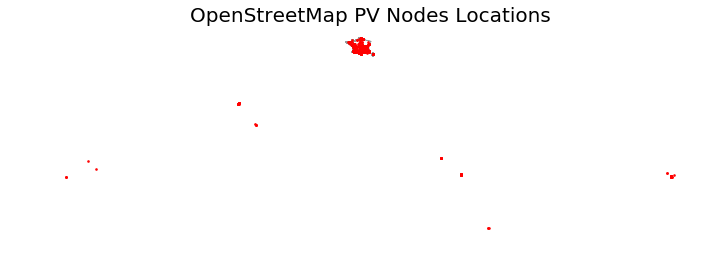

In [69]:
# Plot
fig, ax = plt.subplots(1, figsize=(12, 12))
fr_outline.plot(ax=ax, color='white', linewidth=0.8, edgecolor='0.6')
osm_df_fr.plot(ax=ax, markersize=2, color='red', alpha=0.4)



ax.set_title("OpenStreetMap PV Nodes Locations", fontdict={'fontsize': '20', 'fontweight' : '3'})
ax.axis('off')
plt.show()

The PV locations in France include overseas location, which appear on the plot.

#### Plot nodes interactively

In [72]:
# Store all nodes coordinates for plotting
osm_folium_fr = osm_df_fr[osm_df_fr.lat.notna()]
print(len(osm_folium_fr))
osm_folium_fr.head(1)

9998


,type,id,nodes,tags,lat,lon,geometry
1801,node,6920323790,NaN,NaN,-22.644386,-152.797522,POINT (-152.79752 -22.64439)


In [73]:
# Check out map
m = folium.Map([45.751, 1.9950], zoom_start=6, tiles='cartodbpositron')

locations = []
popups = []
for idx, row in osm_folium_fr.iterrows():
    locations.append([row['geometry'].y, row['geometry'].x])
    popups.append((row['geometry'].y, row['geometry'].x))

s = folium.FeatureGroup(name='Solar PV')
s.add_children(MarkerCluster(locations=locations, popups=popups))
m.add_children(s)
m.add_child(folium.LatLngPopup())

####  Extract and save all Polygons

In [74]:
# Getting only ways from OSM
osm_pv_fr = getSolarPanelsFromOSM(country="France", read_from_pickle=True, pickle_read_name="fr_panels", 
                                  pickle_write_name="fr_panels", folder_with_output_files='OSM_coord')
osm_df_fr = pd.DataFrame(osm_pv_fr)
ways_fr = osm_df_fr[osm_df_fr.type=='way']
ways_fr.head(3)

Query Open Street Map for solar panels in France.
Done.


,type,id,nodes,tags,lat,lon
0,way,42864089,"[536527189, 536527177, 536527175, 536527188, 5...","{'generator:output:electricity': 'yes', 'gener...",NaN,NaN
1,way,63487533,"[786270990, 786077609, 786104086, 786086464, 7...","{'addr:city': 'Cournon-d'Auvergne', 'addr:hous...",NaN,NaN
2,way,64834202,"[794904384, 794904672, 794906993, 794908269, 7...","{'generator:method': 'photovoltaic', 'generato...",NaN,NaN


In [75]:
# obtain shape coordinates of all solar ways
all_shapes_fr = [get_coord(ways_fr['nodes'][i], osm_df_fr) for i in range(len(ways_fr))]

In [76]:
# convert shape coordinates to shapely polygons and to geodataframe
ways_fr['geometry'] = all_shapes_fr
ways_fr['geometry'] = ways_fr['geometry'].apply(lambda x: Polygon(x)) # convert to shapely Polygon
ways_fr = gpd.GeoDataFrame(ways_fr, crs={'init': 'epsg:4326'}) # convert to geodataframe
ways_fr = ways_fr.drop(columns=['lat', 'lon'])
ways_fr.head(1)

,type,id,nodes,tags,geometry
0,way,42864089,"[536527189, 536527177, 536527175, 536527188, 5...","{'generator:output:electricity': 'yes', 'gener...","POLYGON ((168.01582 -21.56200, 168.01582 -21.5..."


In [77]:
# get x and y coord of centroids based on Polygon
ways_for_json_fr = ways_fr
ways_for_json_fr["centroid_lon"] = ways_for_json_fr['geometry'].centroid.x
ways_for_json_fr["centroid_lat"] = ways_for_json_fr['geometry'].centroid.y
ways_for_json_fr.head(1)

,type,id,nodes,tags,geometry,centroid_lon,centroid_lat
0,way,42864089,"[536527189, 536527177, 536527175, 536527188, 5...","{'generator:output:electricity': 'yes', 'gener...","POLYGON ((168.01582 -21.56200, 168.01582 -21.5...",168.015851,-21.562026


In [78]:
# convert to json and write to disk
ways_for_json_fr_full = ways_for_json_fr.to_json()
with open('../Data/OSM_coord/fr_panels.geojson', 'w') as f:
    dump(ways_for_json_fr_full, f)
print('Successfully wrote a json file with all solar ways shapes and centroid coordinates.')

Successfully wrote a json file with all solar ways shapes and centroid coordinates.


#### Plot polygons

We can even visualize the json file in browser using `geojsonio`. Note that we only plot the first 200 panels, if we try to plot a too big file `geojsonio` tries to create a gist on GitHub and requires authentification.

In [79]:
# visualise geojson in browser
ways_for_json_plot_fr = ways_for_json_fr.head(200).to_json()
geojsonio.display(ways_for_json_plot_fr)

'http://geojson.io/#data=data:application/json,%7B%22type%22%3A%20%22FeatureCollection%22%2C%20%22features%22%3A%20%5B%7B%22id%22%3A%20%220%22%2C%20%22type%22%3A%20%22Feature%22%2C%20%22properties%22%3A%20%7B%22centroid_lat%22%3A%20-21.562025903401036%2C%20%22centroid_lon%22%3A%20168.0158505160079%2C%20%22id%22%3A%2042864089%2C%20%22nodes%22%3A%20%5B536527189%2C%20536527177%2C%20536527175%2C%20536527188%2C%20536527189%5D%2C%20%22tags%22%3A%20%7B%22generator%3Aoutput%3Aelectricity%22%3A%20%22yes%22%2C%20%22generator%3Asource%22%3A%20%22solar%22%2C%20%22name%22%3A%20%22Panneaux%20photovoltaiques%20de%20la%20L%5Cu00e9pros%5Cu00e9rie%22%2C%20%22power%22%3A%20%22generator%22%7D%2C%20%22type%22%3A%20%22way%22%7D%2C%20%22geometry%22%3A%20%7B%22type%22%3A%20%22Polygon%22%2C%20%22coordinates%22%3A%20%5B%5B%5B168.015822%2C%20-21.5620018%5D%2C%20%5B168.015822%2C%20-21.5620532%5D%2C%20%5B168.015881%2C%20-21.5620514%5D%2C%20%5B168.0158753%2C%20-21.5619956%5D%2C%20%5B168.015822%2C%20-21.5620018%5D%5

### Belgium

#### Query

In [80]:
osm_pv_be = getSolarPanelsFromOSM(country="Belgium", read_from_pickle=False, pickle_read_name=None, 
                                  pickle_write_name="be_panels", folder_with_output_files='OSM_coord')

Query Open Street Map for solar panels in Belgium.
Done.


In [81]:
# Convert to dataframe
osm_df_be = pd.DataFrame(osm_pv_be)
osm_df_be.head(1)

,type,id,nodes,tags,lat,lon
0,way,87681545,"[1019715353, 1019715365, 1019715349, 101971536...","{'building': 'yes', 'generator:method': 'photo...",NaN,NaN


In [82]:
# Count nb of nodes and ways
print(len(osm_df_be))
print(osm_df_be.groupby('type').count())

3850
        id  nodes  tags   lat   lon
type                               
node  3194      0     0  3194  3194
way    656    656   656     0     0


In [83]:
# Convert to geo dataframe
osm_df_be['geometry'] = list(zip(osm_df_be['lon'], osm_df_be['lat']))
osm_df_be['geometry'] = osm_df_be['geometry'].apply(lambda x: Point(x))
osm_df_be = gpd.GeoDataFrame(osm_df_be, crs={'init': 'epsg:4326'}) # OSM comes in this coordinate system
osm_df_be.head(1)

,type,id,nodes,tags,lat,lon,geometry
0,way,87681545,"[1019715353, 1019715365, 1019715349, 101971536...","{'building': 'yes', 'generator:method': 'photo...",NaN,NaN,POINT (nan nan)


#### Plot nodes

In [84]:
# You can download country shapefiles from: http://www.diva-gis.org/gdata

# Grab BE outline
be_outline = gpd.read_file('../Data/OSM_coord/BEL_adm/BEL_adm1.shp')

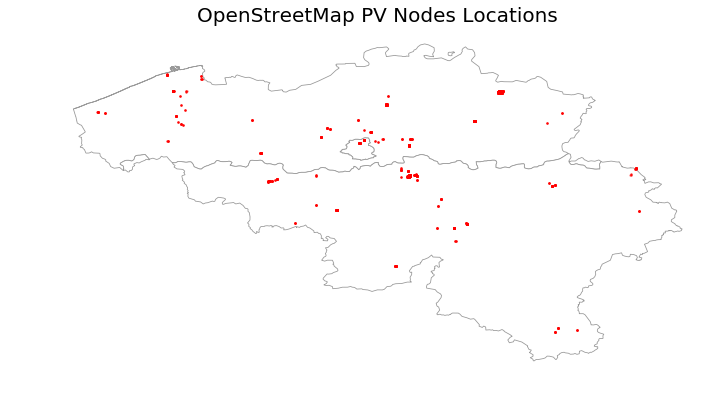

In [85]:
# Plot
fig, ax = plt.subplots(1, figsize=(12, 12))
be_outline.plot(ax=ax, color='white', linewidth=0.8, edgecolor='0.6')
osm_df_be.plot(ax=ax, markersize=2, color='red', alpha=0.4)

ax.set_title("OpenStreetMap PV Nodes Locations", fontdict={'fontsize': '20', 'fontweight' : '3'})
ax.axis('off')
plt.show()

#### Plot nodes interactively

In [86]:
# Store all nodes coordinates for plotting
osm_folium_be = osm_df_be[osm_df_be.lat.notna()]
print(len(osm_folium_be))
osm_folium_be.head(1)

3194


,type,id,nodes,tags,lat,lon,geometry
656,node,6139462810,NaN,NaN,49.680877,5.605361,POINT (5.60536 49.68088)


In [87]:
# Check out map
m = folium.Map([50.5, 4.6], zoom_start=6, tiles='cartodbpositron')

locations = []
popups = []
for idx, row in osm_folium_be.iterrows():
    locations.append([row['geometry'].y, row['geometry'].x])
    popups.append((row['geometry'].y, row['geometry'].x))
    
s = folium.FeatureGroup(name='Solar PV')
s.add_children(MarkerCluster(locations=locations, popups=popups))
m.add_children(s)
m.add_child(folium.LatLngPopup())

####  Extract and save all Polygons

In [88]:
# Getting only ways from OSM
osm_pv_be = getSolarPanelsFromOSM(country="Belgium", read_from_pickle=True, pickle_read_name="be_panels", 
                               pickle_write_name="be_panels", folder_with_output_files='OSM_coord')
osm_df_be = pd.DataFrame(osm_pv_be)
ways_be = osm_df_be[osm_df_be.type=='way']
ways_be.head(3)

Query Open Street Map for solar panels in Belgium.
Done.


,type,id,nodes,tags,lat,lon
0,way,87681545,"[1019715353, 1019715365, 1019715349, 101971536...","{'building': 'yes', 'generator:method': 'photo...",NaN,NaN
1,way,104203306,"[1202324836, 3014749369, 1202324682, 120232480...","{'area': 'yes', 'generator:method': 'photovolt...",NaN,NaN
2,way,132022152,"[1452654142, 1452654143, 1452654150, 145265415...","{'generator:method': 'photovoltaic', 'generato...",NaN,NaN


In [89]:
# obtain shape coordinates of all solar ways
all_shapes_be = [get_coord(ways_be['nodes'][i], osm_df_be) for i in range(len(ways_be))]

In [90]:
# convert shape coordinates to shapely polygons and to geodataframe
ways_be['geometry'] = all_shapes_be
ways_be['geometry'] = ways_be['geometry'].apply(lambda x: Polygon(x)) # convert to shapely Polygon
ways_be = gpd.GeoDataFrame(ways_be, crs={'init': 'epsg:4326'}) # convert to geodataframe
ways_be = ways_be.drop(columns=['lat', 'lon'])
ways_be.head(1)

,type,id,nodes,tags,geometry
0,way,87681545,"[1019715353, 1019715365, 1019715349, 101971536...","{'building': 'yes', 'generator:method': 'photo...","POLYGON ((5.04290 50.36790, 5.04305 50.36805, ..."


In [91]:
# get x and y coord of centroids based on Polygon
ways_for_json_be = ways_be
ways_for_json_be["centroid_lon"] = ways_for_json_be['geometry'].centroid.x
ways_for_json_be["centroid_lat"] = ways_for_json_be['geometry'].centroid.y
ways_for_json_be.head(1)

,type,id,nodes,tags,geometry,centroid_lon,centroid_lat
0,way,87681545,"[1019715353, 1019715365, 1019715349, 101971536...","{'building': 'yes', 'generator:method': 'photo...","POLYGON ((5.04290 50.36790, 5.04305 50.36805, ...",5.043307,50.367861


In [92]:
# convert to json and write to disk
ways_for_json_be_full = ways_for_json_be.to_json()
with open('../Data/OSM_coord/be_panels.geojson', 'w') as f:
    dump(ways_for_json_be_full, f)
print('Successfully wrote a json file with all solar ways shapes and centroid coordinates.')

Successfully wrote a json file with all solar ways shapes and centroid coordinates.


#### Plot polygons

We can even visualize the json file in browser using `geojsonio`. Note that we only plot the first 200 panels, if we try to plot a too big file `geojsonio` tries to create a gist on GitHub and requires authentification.

In [93]:
# visualise geojson in browser
ways_for_json_plot_be = ways_for_json_be.head(200).to_json()
geojsonio.display(ways_for_json_plot_be)

'http://geojson.io/#data=data:application/json,%7B%22type%22%3A%20%22FeatureCollection%22%2C%20%22features%22%3A%20%5B%7B%22id%22%3A%20%220%22%2C%20%22type%22%3A%20%22Feature%22%2C%20%22properties%22%3A%20%7B%22centroid_lat%22%3A%2050.36786055876561%2C%20%22centroid_lon%22%3A%205.043306940920206%2C%20%22id%22%3A%2087681545%2C%20%22nodes%22%3A%20%5B1019715353%2C%201019715365%2C%201019715349%2C%201019715366%2C%201019715351%2C%201019715350%2C%201019715353%5D%2C%20%22tags%22%3A%20%7B%22building%22%3A%20%22yes%22%2C%20%22generator%3Amethod%22%3A%20%22photovoltaic%22%2C%20%22generator%3Aoutput%3Aelectricity%22%3A%20%22yes%22%2C%20%22generator%3Aplace%22%3A%20%22roof%22%2C%20%22generator%3Asource%22%3A%20%22solar%22%2C%20%22generator%3Atype%22%3A%20%22solar_photovoltaic_panel%22%2C%20%22name%22%3A%20%22Ecomarch%5Cu00e9%20Assesse%22%2C%20%22power%22%3A%20%22generator%22%2C%20%22shop%22%3A%20%22supermarket%22%7D%2C%20%22type%22%3A%20%22way%22%7D%2C%20%22geometry%22%3A%20%7B%22type%22%3A%20%22Po

### Netherlands

#### Query

In [96]:
osm_pv_nl = getSolarPanelsFromOSM(country="Nederland", read_from_pickle=True, pickle_read_name='nl_panels', 
                                  pickle_write_name="nl_panels", folder_with_output_files='OSM_coord')

Query Open Street Map for solar panels in Nederland.
Done.


In [97]:
# Convert to dataframe
osm_df_nl = pd.DataFrame(osm_pv_nl)
osm_df_nl.head(1)

,type,id,nodes,tags,lat,lon
0,way,277169168,"[2816969669, 2816969536, 2816969741, 281696975...","{'building': 'yes', 'frequency': '50', 'genera...",NaN,NaN


In [98]:
# Count nb of nodes and ways
print(len(osm_df_nl))
print(osm_df_nl.groupby('type').count())

27382
         id  nodes  tags    lat    lon
type                                  
node  22183      0     0  22183  22183
way    5199   5199  5199      0      0


In [99]:
# Convert to geo dataframe
osm_df_nl['geometry'] = list(zip(osm_df_nl['lon'], osm_df_nl['lat']))
osm_df_nl['geometry'] = osm_df_nl['geometry'].apply(lambda x: Point(x))
osm_df_nl = gpd.GeoDataFrame(osm_df_nl, crs={'init': 'epsg:4326'}) # OSM comes in this coordinate system
osm_df_nl.head(1)

,type,id,nodes,tags,lat,lon,geometry
0,way,277169168,"[2816969669, 2816969536, 2816969741, 281696975...","{'building': 'yes', 'frequency': '50', 'genera...",NaN,NaN,POINT (nan nan)


#### Plot nodes

In [100]:
# You can download country shapefiles from: http://www.diva-gis.org/gdata

# Grab NL outline
nl_outline = gpd.read_file('../Data/OSM_coord/NLD_adm/NLD_adm0.shp')

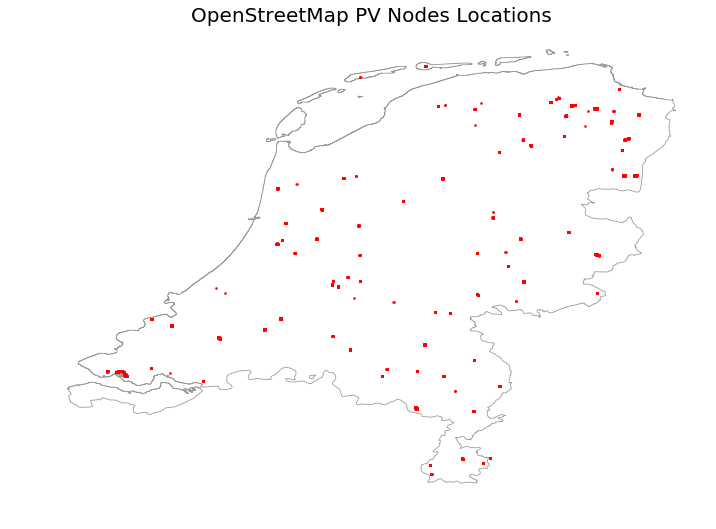

In [101]:
# Plot
fig, ax = plt.subplots(1, figsize=(12, 12))
nl_outline.plot(ax=ax, color='white', linewidth=0.8, edgecolor='0.6')
osm_df_nl[5250:].plot(ax=ax, markersize=2, color='red', alpha=0.4)
# Remark: I started plotting at 5250, to avoid overseas location.
# I found where these overseas panels are in the dataframe using: osm_df_nl.lat.idxmin()

ax.set_title("OpenStreetMap PV Nodes Locations", fontdict={'fontsize': '20', 'fontweight' : '3'})
ax.axis('off')
plt.show()

#### Plot nodes interactively

In [102]:
# Store all nodes coordinates for plotting
osm_folium_nl = osm_df_nl[osm_df_nl.lat.notna()]
print(len(osm_folium_nl))
osm_folium_nl.head(1)

22183


,type,id,nodes,tags,lat,lon,geometry
5199,node,1753797979,NaN,NaN,12.504852,-70.00909,POINT (-70.00909 12.50485)


In [103]:
# Check out map
m = folium.Map([50.5, 4.6], zoom_start=6, tiles='cartodbpositron')

locations = []
popups = []
for idx, row in osm_folium_nl.iterrows():
    locations.append([row['geometry'].y, row['geometry'].x])
    popups.append((row['geometry'].y, row['geometry'].x))

s = folium.FeatureGroup(name='Solar PV')
s.add_children(MarkerCluster(locations=locations, popups=popups))
m.add_children(s)

####  Extract and save all Polygons

In [104]:
# Getting only ways from OSM
osm_pv_nl = getSolarPanelsFromOSM(country="Nederland", read_from_pickle=True, pickle_read_name="nl_panels", 
                                  pickle_write_name="nl_panels", folder_with_output_files='OSM_coord')
osm_df_nl = pd.DataFrame(osm_pv_nl)
ways_nl = osm_df_nl[osm_df_nl.type=='way']
ways_nl.head(3)

Query Open Street Map for solar panels in Nederland.
Done.


,type,id,nodes,tags,lat,lon
0,way,277169168,"[2816969669, 2816969536, 2816969741, 281696975...","{'building': 'yes', 'frequency': '50', 'genera...",NaN,NaN
1,way,426797487,"[4260640517, 4260640518, 4260640519, 426064052...","{'generator:method': 'photovoltaic', 'generato...",NaN,NaN
2,way,466653881,"[4614104995, 4614104996, 4614104997, 461410499...","{'generator:method': 'photovoltaic', 'generato...",NaN,NaN


In [105]:
# obtain shape coordinates of all solar ways
all_shapes_nl = [get_coord(ways_nl['nodes'][i], osm_df_nl) for i in range(len(ways_nl))]

In [106]:
# convert shape coordinates to shapely polygons and to geodataframe
ways_nl['geometry'] = all_shapes_nl
ways_nl['geometry'] = ways_nl['geometry'].apply(lambda x: Polygon(x)) # convert to shapely Polygon
ways_nl = gpd.GeoDataFrame(ways_nl, crs={'init': 'epsg:4326'}) # convert to geodataframe
ways_nl = ways_nl.drop(columns=['lat', 'lon'])
ways_nl.head(1)

,type,id,nodes,tags,geometry
0,way,277169168,"[2816969669, 2816969536, 2816969741, 281696975...","{'building': 'yes', 'frequency': '50', 'genera...","POLYGON ((6.26168 51.93112, 6.26105 51.93101, ..."


In [107]:
# get x and y coord of centroids based on Polygon
ways_for_json_nl = ways_nl
ways_for_json_nl["centroid_lon"] = ways_for_json_nl['geometry'].centroid.x
ways_for_json_nl["centroid_lat"] = ways_for_json_nl['geometry'].centroid.y
ways_for_json_nl.head(1)

,type,id,nodes,tags,geometry,centroid_lon,centroid_lat
0,way,277169168,"[2816969669, 2816969536, 2816969741, 281696975...","{'building': 'yes', 'frequency': '50', 'genera...","POLYGON ((6.26168 51.93112, 6.26105 51.93101, ...",6.26129,51.931254


In [108]:
# convert to json and write to disk
ways_for_json_nl_full = ways_for_json_nl.to_json()
with open('../Data/OSM_coord/nl_panels.geojson', 'w') as f:
    dump(ways_for_json_nl_full, f)
print('Successfully wrote a json file with all solar ways shapes and centroid coordinates.')

Successfully wrote a json file with all solar ways shapes and centroid coordinates.


#### Plot polygons

We can even visualize the json file in browser using `geojsonio`. Note that we only plot the first 200 panels, if we try to plot a too big file `geojsonio` tries to create a gist on GitHub and requires authentification.

In [109]:
# visualise geojson in browser
ways_for_json_plot_nl = ways_for_json_nl.head(200).to_json()
geojsonio.display(ways_for_json_plot_nl)

'http://geojson.io/#data=data:application/json,%7B%22type%22%3A%20%22FeatureCollection%22%2C%20%22features%22%3A%20%5B%7B%22id%22%3A%20%220%22%2C%20%22type%22%3A%20%22Feature%22%2C%20%22properties%22%3A%20%7B%22centroid_lat%22%3A%2051.93125403801959%2C%20%22centroid_lon%22%3A%206.261289784118903%2C%20%22id%22%3A%20277169168%2C%20%22nodes%22%3A%20%5B2816969669%2C%202816969536%2C%202816969741%2C%202816969755%2C%202816969931%2C%202816959521%2C%202816959532%2C%202816959545%2C%202816969812%2C%202816969832%2C%202816969669%5D%2C%20%22tags%22%3A%20%7B%22building%22%3A%20%22yes%22%2C%20%22frequency%22%3A%20%2250%22%2C%20%22generator%3Amethod%22%3A%20%22photovoltaic%22%2C%20%22generator%3Aoutput%3Aelectricity%22%3A%20%22yes%22%2C%20%22generator%3Asource%22%3A%20%22solar%22%2C%20%22generator%3Atype%22%3A%20%22solar_photovoltaic_panel%22%2C%20%22power%22%3A%20%22generator%22%2C%20%22ref%3Abag%22%3A%20%221955100000005065%22%2C%20%22source%22%3A%20%22BAG%22%2C%20%22source%3Adate%22%3A%20%222014-03-2

## Work directly with OSM geojson files

The above method to query OSM coordinates returns a mix of points and ways, all cast into points. We have to make lots of transformations to get shapes as a clean geodataframe.  

Instead, we can go to https://overpass-turbo.eu/, use the solar queries (see below) and then click 'export' (and choose geojson format). The resulting export file will then be well-behaved for plotting / calculating areas.

In [110]:
# solar ways query example (you need to copy/paste it without the """):
"""
            [out:json];
            area["int_name"="Belgium"]->.searchArea;
            (
            way(area.searchArea)["generator:source"="solar"]['generator:output:electricity'='yes'];
            );
            out body;
            >;
            out skel qt;
"""

'\n            [out:json];\n            area["int_name"="Belgium"]->.searchArea;\n            (\n            way(area.searchArea)["generator:source"="solar"][\'generator:output:electricity\'=\'yes\'];\n            );\n            out body;\n            >;\n            out skel qt;\n'

Make sure to rename the downloaded file correctly and to put it in the right folder before going through the rest of the notebook.

### UK

#### Export geojson from Overpass API

In [111]:
export = gpd.read_file('../Data/OSM_coord/export_uk.geojson')

In [112]:
export.head(1)
# equivalent to export[0:1]

,id,@id,PMSA_ref,architect,artist_name,artwork:erected,artwork:type,building,generator:output:electricity,generator:source,...,building:material,direction,roof:colour,manufacturer,area,barrier,generator:modules,generator:tilt,source_ref,geometry
0,way/21819997,way/21819997,WMbiBIxx207,Faulks Perry Culley & Rech,Richard Martin,1997,building;light sculpture,industrial,yes,solar,...,None,None,None,None,None,None,None,None,None,"POLYGON ((-1.84469 52.46031, -1.84510 52.45999..."


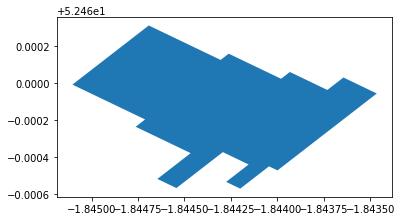

In [113]:
export[0:1].plot()
plt.show()

#### Compute polygon areas & power

In [114]:
# count features present in the geojson file
export.count()

id                   13213
@id                  13213
PMSA_ref                 1
architect                1
artist_name              1
                     ...  
barrier                  2
generator:modules       13
generator:tilt           1
source_ref               2
geometry             13213
Length: 83, dtype: int64

A small number of these polygons do have notional areas.  
We can infer area from the polygon, after converting into a cartesian system (i.e. in meters).  
TODO: check this is correct.

In [115]:
# Convert to Cartesian system (EPSG:3857, unit=m)              
export2 = export.copy()
export2 = export2.to_crs({'init': 'epsg:3857'})
export2["area"] = export2['geometry'].area

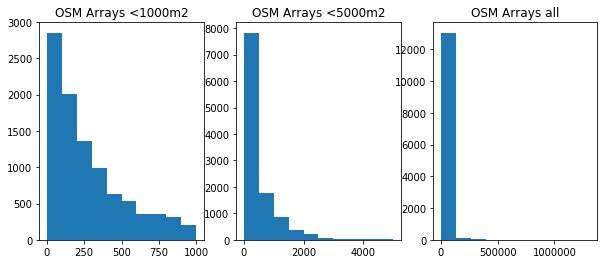

In [116]:
# Assess distribution
f, ax = plt.subplots(1, 3, figsize=(10,4)) 
ax[0].hist(export2[export2['area'] < 1000]['area'])
ax[1].hist(export2[export2['area'] < 5000]['area'])
ax[2].hist(export2['area'])
ax[0].set_title('OSM Arrays <1000m2')
ax[1].set_title('OSM Arrays <5000m2')
ax[2].set_title('OSM Arrays all')
plt.show()

Most of the data is constituted of small areas (under 400m2), which might correspond to personal houses and commercial buildings.

Let's try to convert these areas to kW power. For reference, a 4kW array is around 29m2 - i.e. around 1kW per 7.5m2.

In [117]:
export2['power'] = export2['area']/7.5

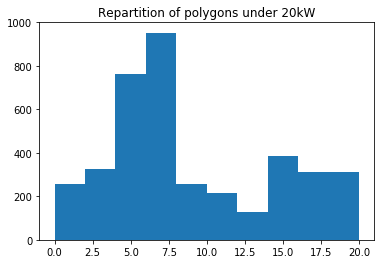

In [118]:
plt.hist(export2[export2['power']<20]['power'])
plt.title('Repartition of polygons under 20kW')
plt.show()

In [119]:
print('We have ≈{} PV polygons sized under 50kW, and {} under 100kW.'.format(len(export2[export2['power']<50]),
                                                                             len(export2[export2['power']<100])))

We have ≈6931 PV polygons sized under 50kW, and 8864 under 100kW.


These computations might be incorrect, we would need to re-check.

However even with worries about size accuracy, we get some orders of magnitude!

### France

#### Export geojson from Overpass API

In [120]:
export_fr = gpd.read_file('../Data/OSM_coord/export_fr.geojson')
export_fr.head(1)

,id,@id,generator:output:electricity,generator:source,name,power,addr:city,addr:housenumber,addr:postcode,addr:street,...,shelter,construction,industrial,fixme,generator:output:hot_water,roof:direction,source:geometry,level,generator:plant,geometry
0,way/42864089,way/42864089,yes,solar,Panneaux photovoltaiques de la Léprosérie,generator,None,None,None,None,...,None,None,None,None,None,None,None,None,None,"POLYGON ((168.01582 -21.56200, 168.01582 -21.5..."


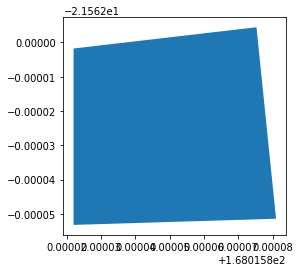

In [121]:
export_fr[0:1].plot()
plt.show()

#### Compute polygon areas & power

In [122]:
# count features present in the geojson file
export_fr.count()

id                              1801
@id                             1801
generator:output:electricity    1801
generator:source                1801
name                              13
power                           1791
addr:city                          7
addr:housenumber                   1
addr:postcode                      1
addr:street                        1
building                         544
generator:method                1757
generator:type                  1677
source                           423
shop                               2
wheelchair                         1
wall                             263
proposed                           1
historic                           1
brand                              1
brand:wikidata                     1
brand:wikipedia                    1
location                          60
opening_hours                      1
roof:shape                         7
access                             2
note                               3
f

A small number of these polygons do have notional areas.  
We can infer area from the polygon, after converting into a cartesian system (i.e. in meters).  
TODO: check this is correct.

In [123]:
# Convert to Cartesian system (EPSG:3857, unit= m)              
export2_fr = export_fr.copy()
export2_fr = export2_fr.to_crs({'init': 'epsg:3857'})
export2_fr["area"] = export2_fr['geometry'].area

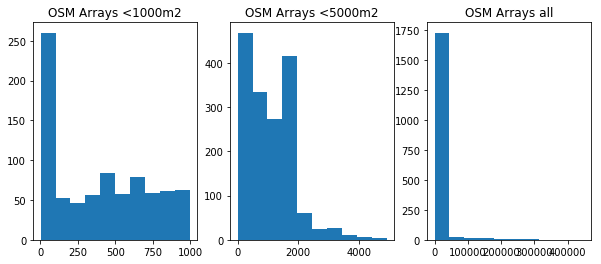

In [124]:
# Assess distribution
f, ax = plt.subplots(1, 3, figsize=(10,4)) 
ax[0].hist(export2_fr[export2_fr['area'] < 1000]['area'])
ax[1].hist(export2_fr[export2_fr['area'] < 5000]['area'])
ax[2].hist(export2_fr['area'])
ax[0].set_title('OSM Arrays <1000m2')
ax[1].set_title('OSM Arrays <5000m2')
ax[2].set_title('OSM Arrays all')
plt.show()

We can see a peaks for very small areas (cf. the first bar in the 1st plot, with polygons under 100m2), which might correspond to personal houses. There are also lots of areas of sizes up to 2000m2, which might correspond to PV panels on commercial buildings or in fields.

Let's try to convert these areas to kW power. For reference, a 4kW array is around 29m2 - i.e. around 1kW per 7.5m2.

In [125]:
export2_fr['power'] = export2_fr['area']/7.5

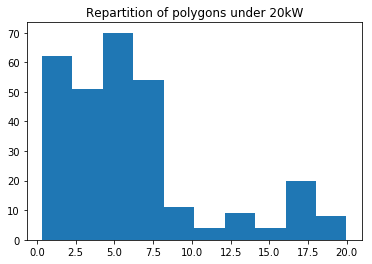

In [126]:
plt.hist(export2_fr[export2_fr['power']<20]['power'])
plt.title('Repartition of polygons under 20kW')
plt.show()

In [127]:
print('We have ≈{} PV polygons sized under 50kW, and {} under 100kW.'.format(len(export2_fr[export2_fr['power']<50]),
                                                                             len(export2_fr[export2_fr['power']<100])))

We have ≈395 PV polygons sized under 50kW, and 685 under 100kW.


These computations might be incorrect, we would need to re-check.

However even with worries about size accuracy, we get some orders of magnitude!

### Belgium

#### Export geojson from Overpass API

In [128]:
export_be = gpd.read_file('../Data/OSM_coord/export_be.geojson')
export_be.head(1)

,id,@id,building,generator:method,generator:output:electricity,generator:place,generator:source,generator:type,name,power,...,description,generator:orientation,location,fixme,image,website,generator:solar:modules,source:geometry,layer,geometry
0,way/87681545,way/87681545,yes,photovoltaic,yes,roof,solar,solar_photovoltaic_panel,Ecomarché Assesse,generator,...,None,None,None,None,None,None,None,None,None,"POLYGON ((5.04290 50.36790, 5.04350 50.36763, ..."


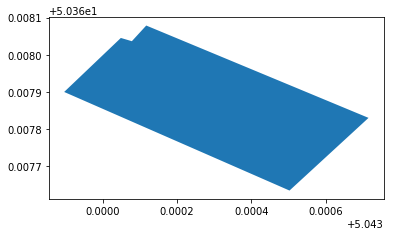

In [129]:
export_be[0:1].plot()
plt.show()

#### Compute polygon areas & power

In [130]:
# count features present in the geojson file
export_be.count()

id                              656
@id                             656
building                         29
generator:method                645
generator:output:electricity    656
generator:place                  21
generator:source                656
generator:type                  623
name                              3
power                           656
shop                              1
area                              2
addr:city                        23
addr:housenumber                 22
addr:postcode                    23
addr:street                      22
addr:suburb                       2
addr:country                     19
amenity                           1
operator                          2
barrier                           1
source                           17
start_date                        2
description                       1
generator:orientation           104
location                        447
fixme                             1
image                       

A small number of these polygons do have notional areas.  
We can infer area from the polygon, after converting into a cartesian system (i.e. in meters).  
TODO: check this is correct.

In [131]:
# Convert to Cartesian system (EPSG:3857, unit= m)              
export2_be = export_be.copy()
export2_be = export2_be.to_crs({'init': 'epsg:3857'})
export2_be["area"] = export2_be['geometry'].area

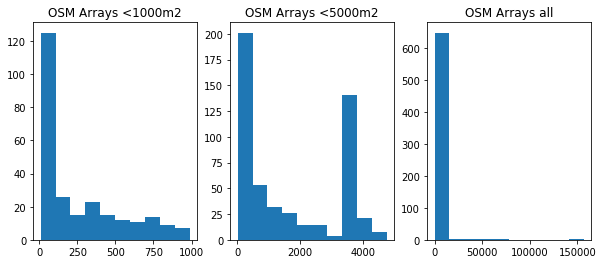

In [132]:
# Assess distribution
f, ax = plt.subplots(1, 3, figsize=(10,4)) 
ax[0].hist(export2_be[export2_be['area'] < 1000]['area'])
ax[1].hist(export2_be[export2_be['area'] < 5000]['area'])
ax[2].hist(export2_be['area'])
ax[0].set_title('OSM Arrays <1000m2')
ax[1].set_title('OSM Arrays <5000m2')
ax[2].set_title('OSM Arrays all')
plt.show()

We can see 2 peaks:
* very small areas (cf. the first bar in the 1st plot, with polygons under 100m2), which might correspond to personal houses
* large areas (around 3500-4000m2 in the 2nd plot), which might correspond to PV panels on commercial buildings or in fields.
The few very large areas in the 3rd plot might be mistakes or solar farms. 

Let's try to convert these areas to kW power. For reference, a 4kW array is around 29m2 - i.e. around 1kW per 7.5m2.

In [133]:
export2_be['power'] = export2_be['area']/7.5

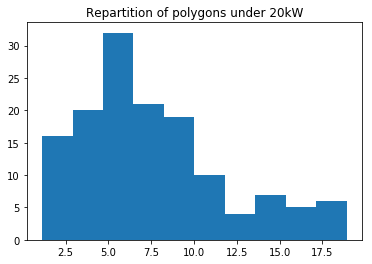

In [134]:
plt.hist(export2_be[export2_be['power']<20]['power'])
plt.title('Repartition of polygons under 20kW')
plt.show()

In [135]:
print('We have ≈{} PV polygons sized under 50kW, and {} under 100kW.'.format(len(export2_be[export2_be['power']<50]),
                                                                             len(export2_be[export2_be['power']<100])))

We have ≈183 PV polygons sized under 50kW, and 236 under 100kW.


These computations might be incorrect, we would need to re-check.

However even with worries about size accuracy, we get some orders of magnitude!

### Netherlands

#### Export geojson from Overpass API

In [136]:
export_nl = gpd.read_file('../Data/OSM_coord/export_nl.geojson')
export_nl.head(1)

,id,@id,building,frequency,generator:method,generator:output:electricity,generator:source,generator:type,power,ref:bag,...,generator:solar:modules,noname,floating,note,url,generator:output,ref,generator:orientation,colour,geometry
0,way/277169168,way/277169168,yes,50,photovoltaic,yes,solar,solar_photovoltaic_panel,generator,1955100000005065,...,None,None,None,None,None,None,None,None,None,"POLYGON ((6.26168 51.93112, 6.26159 51.93134, ..."


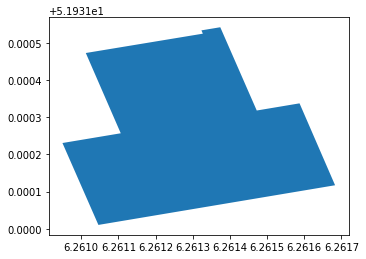

In [137]:
export_nl[0:1].plot()
plt.show()

#### Compute polygon areas & power

In [138]:
# count features present in the geojson file
export_nl.count()

id                              5199
@id                             5199
building                           7
frequency                         30
generator:method                5199
generator:output:electricity    5199
generator:source                5199
generator:type                  5198
power                           5199
ref:bag                            1
source                            42
source:date                        1
start_date                        38
voltage                           30
name                               9
operator                          98
location                        4905
generator:place                  134
amenity                            1
layer                             37
plant:method                       2
plant:output:electricity           2
plant:source                       2
plant:type                         2
capacity                           1
landuse                            1
website                            1
g

A small number of these polygons do have notional areas.  
We can infer area from the polygon, after converting into a cartesian system (i.e. in meters).  
TODO: check this is correct.

In [139]:
# Convert to Cartesian system (EPSG:3857, unit= m)              
export2_nl = export_nl.copy()
export2_nl = export2_nl.to_crs({'init': 'epsg:3857'})
export2_nl["area"] = export2_nl['geometry'].area

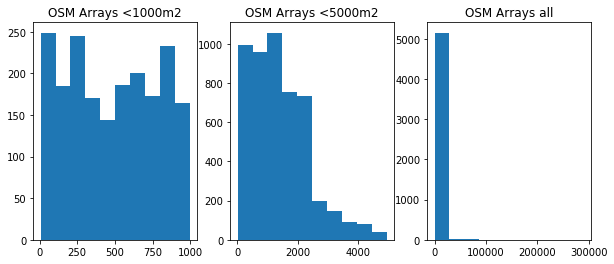

In [140]:
# Assess distribution
f, ax = plt.subplots(1, 3, figsize=(10,4)) 
ax[0].hist(export2_nl[export2_nl['area'] < 1000]['area'])
ax[1].hist(export2_nl[export2_nl['area'] < 5000]['area'])
ax[2].hist(export2_nl['area'])
ax[0].set_title('OSM Arrays <1000m2')
ax[1].set_title('OSM Arrays <5000m2')
ax[2].set_title('OSM Arrays all')
plt.show()

Areas seem to distributed regularly, from small solar arrays to arrays up to ≈2000m2.

Let's try to convert these areas to kW power. For reference, a 4kW array is around 29m2 - i.e. around 1kW per 7.5m2.

In [141]:
export2_nl['power'] = export2_nl['area']/7.5

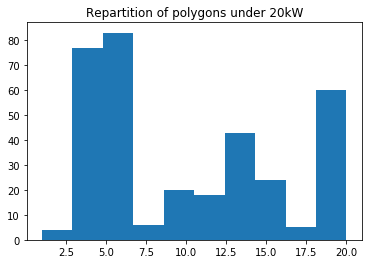

In [142]:
plt.hist(export2_nl[export2_nl['power']<20]['power'])
plt.title('Repartition of polygons under 20kW')
plt.show()

In [143]:
print('We have ≈{} PV polygons sized under 50kW, and {} under 100kW.'.format(len(export2_nl[export2_nl['power']<50]),
                                                                             len(export2_nl[export2_nl['power']<100])))

We have ≈788 PV polygons sized under 50kW, and 1488 under 100kW.


These computations might be incorrect, we would need to re-check.

However even with worries about size accuracy, we get some orders of magnitude!